<div style="border: solid bisque 2px; padding: 15px; font-size: 16px;"><h1>Проект "Исследование рынка общепита в Москве".</h1></div>

### **Исходная цель исследования:**  
Исследовать рынок общественного питания Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.

### **Этапы исследования:**  

[1. Загрузка данных и подготовка к анализу](#start)

[2. Предобработка данных](#2)

[3. Анализ данных](#3)

- Исследовать количество объектов общественного питания по категориям. 
- Исследовать количество посадочных мест в местах по категориям.
- Посмотреть и проанализировать соотношение сетевых и несетевых заведений в датасете.
- Найти топ-15 популярных сетей в Москве.
- Посмотреть количество заведений и количество заведений каждой категории по районам.
- Исследовать средние рейтинги заведений по районам и категориям.
- Найти топ-15 улиц по количеству заведений.
- Найти улицы, на которых находится только один объект общепита.
- Проанализировать цены в центральном административном округе и других АО.
- Посмотреть какие заведения имеют более низкие рейтинги и выявить взаимосвязь между средним чеком и рейтингом.
- Дать рекомендации для открытия нового заведения.


# 1. Загрузка данных и подготовка к анализу <a id='start'></a>

In [1]:
#импорт библиотек для работы
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import seaborn
import plotly.express as px
from plotly import graph_objects as go
import plotly.express as px
import folium
import plotly
import plotly.graph_objs as go
import plotly.express as px

In [2]:
#загрузка данных
try:
    df = pd.read_csv('/datasets/moscow_places.csv')
except FileNotFoundError:
    df = pd.read_csv('/Users/Professional/Desktop/аналитика/moscow_places.csv')

In [3]:
#знакомство с датасетами
display(df.head(20), df.info(),)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,NaN,NaN,NaN,0,NaN
6,Огни города,"бар,паб","Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,пн 15:00–04:00; вт-вс 15:00–05:00,55.890752,37.524653,4.4,средние,Средний счёт:199 ₽,199.0,NaN,0,45.0
7,Mr. Уголёк,быстрое питание,"Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",55.890636,37.524303,4.7,средние,Средний счёт:200–300 ₽,250.0,NaN,0,45.0
8,Donna Maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.880045,37.539006,4.8,средние,Средний счёт:от 500 ₽,500.0,NaN,0,79.0
9,Готика,кафе,"Москва, Ангарская улица, 39",Северный административный округ,"ежедневно, 12:00–00:00",55.879038,37.524487,4.3,средние,Средний счёт:1000–1200 ₽,1100.0,NaN,0,65.0


None

- В датасете представлено 8406 заведений общественного питания г. Москвы. 
- Тип данных в столбцах 

# 2. Предобработка данных <a id='2'></a>

In [4]:
# проверка на наличие пропусков
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

In [5]:
#  приведем столбец  name  и address к нижнему регистру и проверим на наличие дубликатов
df['name'] = df['name'].str.lower()
df['address'] = df['address'].str.lower()

In [6]:
df[['name', 'address']].duplicated().sum()

4

In [7]:
df[df[['name', 'address']].duplicated()]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
215,кафе,кафе,"москва, парк ангарские пруды",Северный административный округ,"ежедневно, 10:00–22:00",55.881438,37.531848,3.2,NaN,NaN,NaN,NaN,0,NaN
1511,more poke,ресторан,"москва, волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
2420,раковарня клешни и хвосты,"бар,паб","москва, проспект мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0
3109,хлеб да выпечка,кафе,"москва, ярцевская улица, 19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0


In [8]:
# удалим выявленые дубликаты
df.drop_duplicates(subset = ['name', 'address']).reset_index(drop=True)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8397,суши мания,кафе,"москва, профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,0,86.0
8398,миславнес,кафе,"москва, пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,0,150.0
8399,самовар,кафе,"москва, люблинская улица, 112а, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0
8400,чайхана sabr,кафе,"москва, люблинская улица, 112а, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0


In [9]:
df[['name', 'address']].duplicated().sum()

4

In [10]:
df = df.drop_duplicates(subset=['name', 'address'], keep='last')

In [11]:
df[['name', 'address']].duplicated().sum()

0

- Выявлены пропущенные значения в столбцах hours, price, avg_bill, middle_avg_bill, middle_coffee_cup, seats. Пропусков достаточно много, их целесообразно оставить, так как удаление может привести к искажению данных.                
- Проверены на наличие дубликатов колонки с названием заведения и адресом, выявлены и удалены 4 дубликата.

**Создадим столбец street с названиями улиц из столбца с адресом.**

In [12]:
df['street'] = [x.split(',')[1] for x in 
df['address'].values]
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица дыбенко
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица дыбенко
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,клязьминская улица
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица маршала федоренко
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,правобережная улица


In [13]:
#Код ревьюера
df['street'] = [x.split(', ')[1] for x in 
df['address'].values]
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица дыбенко
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица дыбенко
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,клязьминская улица
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица маршала федоренко
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,правобережная улица


In [14]:
#Код ревьюера
df.query('street == "проспект мира"')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
718,все лень,ресторан,"москва, проспект мира, 119, стр. 528",Северо-Восточный административный округ,"пн-чт 12:00–21:00; пт,сб 12:00–22:00; вс 12:00...",55.836107,37.614875,4.4,выше среднего,Средний счёт:от 1500 ₽,1500.0,NaN,0,NaN,проспект мира
786,старое место,кафе,"москва, проспект мира, 119, стр. 504",Северо-Восточный административный округ,"ежедневно, 11:00–22:00",55.837212,37.616469,4.1,средние,Средний счёт:900–1100 ₽,1000.0,NaN,0,NaN,проспект мира
792,doner one,кафе,"москва, проспект мира, 119, стр. 596",Северо-Восточный административный округ,"ежедневно, 11:00–21:00",55.839037,37.613027,4.2,NaN,NaN,NaN,NaN,0,NaN,проспект мира
800,пян-се,быстрое питание,"москва, проспект мира, 119, стр. 27",Северо-Восточный административный округ,"ежедневно, 10:00–20:00",55.834563,37.613549,4.4,NaN,NaN,NaN,NaN,1,NaN,проспект мира
909,космос,кафе,"москва, проспект мира, 119, стр. 34",Северо-Восточный административный округ,вт-вс 10:45–21:00,55.835060,37.622033,3.8,NaN,NaN,NaN,NaN,0,NaN,проспект мира
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2568,ice embassy,кафе,"москва, проспект мира, 26, стр. 2",Центральный административный округ,"ежедневно, круглосуточно",55.777311,37.636400,4.4,NaN,NaN,NaN,NaN,0,273.0,проспект мира
2571,"халва, сеть почтоматов",кафе,"москва, проспект мира, 146",Северо-Восточный административный округ,пн-пт 10:00–19:00,55.820575,37.641970,3.6,NaN,NaN,NaN,NaN,0,18.0,проспект мира
2572,ресторан,ресторан,"москва, проспект мира, 62, стр. 1",Центральный административный округ,NaN,55.785618,37.635511,4.3,NaN,NaN,NaN,NaN,0,200.0,проспект мира
4782,food embassy,ресторан,"москва, проспект мира, 26, стр. 2",Центральный административный округ,"ежедневно, 10:00–00:00",55.777224,37.636288,4.5,высокие,Средний счёт:2500–3000 ₽,2750.0,NaN,0,273.0,проспект мира


**Создадим столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7):**


In [15]:
df['is_24_7'] = df['hours'].str.contains('ежедневно, круглосуточно')
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица дыбенко,False
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица дыбенко,False
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,клязьминская улица,False
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица маршала федоренко,False
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,правобережная улица,False


## Анализ данных<a id='3'></a>

**Какие категории заведений представлены в данных? Исследуйте количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Ответьте на вопрос о распределении заведений по категориям.**

In [16]:
# общее количество заведений
df['name'].count()

8402

In [17]:
# в данных представлены следующие категории заведений
df['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [18]:
# Исследуем количество объектов общественного питания по категориям
t=df.groupby('category')\
    .agg({'name': 'count'})\
    .sort_values(by='name', ascending=False)\
    .rename(columns={'name': 'count'})\
    .reset_index()
t

,category,count
0,кафе,2377
1,ресторан,2041
2,кофейня,1413
3,"бар,паб",765
4,пиццерия,633
5,быстрое питание,603
6,столовая,315
7,булочная,255


In [19]:
fig = px.bar(t, x='category', y='count', text ='count', color='category')
fig.update_xaxes(tickangle=45)
fig.update_layout(showlegend=False,
                  title='Распределение заведений по категориям',
                  xaxis_title="Категории заведений",
                  yaxis_title="Количество заведений")
fig.show()

Больше всего на рынке общественного питания г. Москвы присутствуют кафе 2378 заведений, далее рестораны 2043 заведения, на третьем месте кофейни 1413. Меньше всего булочных 256 заведений и столовых - 315.

**Исследуйте количество посадочных мест по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Проанализируйте результаты и сделайте выводы.**

In [20]:
# Исследуем количество посадочных мест  по категориям
s=df.groupby('category')\
    .agg({'seats': 'sum'})\
    .sort_values(by='seats', ascending=False)\
    .reset_index()
s

,category,seats
0,ресторан,154531.0
1,кафе,118770.0
2,кофейня,83511.0
3,"бар,паб",58281.0
4,пиццерия,40350.0
5,быстрое питание,34513.0
6,столовая,16359.0
7,булочная,12953.0


In [21]:
fig = px.bar(s, x='category', y='seats', text ='seats', color='category')
fig.update_xaxes(tickangle=45)
fig.update_layout(title='Количество посадочных мест по категориям',
                  xaxis_title="Категории заведений",
                  yaxis_title="Количество посадочных мест",
                  showlegend=False)
fig.show()


По количеству посадочных мест выходят на первое место рестораны, на второе поместились кафе, на третьем кофейни. Рейтинг почти полностью соответсвует рейтингу по количеству заведений, поэтому будет целесообразно сравнить количество мест в среднем/медиану одного заведения по категориям. 

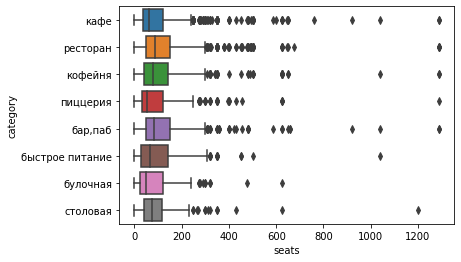

In [22]:
# посмотрим на распределение количества посадочных мест
seaborn.boxplot(data=df, x='seats', y='category')
plt.show()

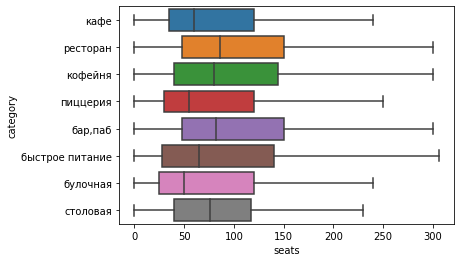

In [23]:
seaborn.boxplot(data=df, x='seats', y='category', showfliers=False)
plt.show()

Боксплоты показывают что распределение данных от 0 до 320 посадочных мест, видно большие выбросы до 1200, их стоит удалить, чтобы не искажать последующий анализ. 

In [24]:
df_new = df.query('seats <= 320')

In [25]:
# Посмотрим медиану количества посадочных мест по категориям
h = df_new.pivot_table(index='category', values='seats', aggfunc='median')\
      .sort_values(by='seats', ascending=False)\
      .reset_index()
h

,category,seats
0,"бар,паб",80.0
1,ресторан,80.0
2,столовая,72.0
3,кофейня,70.0
4,быстрое питание,60.0
5,кафе,57.0
6,пиццерия,50.0
7,булочная,49.0


In [26]:
fig = px.bar(h, x='seats', y='category', text ='seats', color='category')
fig.update_layout(title='Медианное количество посадочных мест на одно заведение по категориям',
                  xaxis_title="Категории заведений",
                  yaxis_title="Количество посадочных мест",
                  showlegend=False)
fig.show()

In [27]:
# Посмотрим среднее количество посадочных мест по категориям
a=df_new.groupby('category')\
    .agg({'seats': 'mean'})\
    .sort_values(by='seats', ascending=False)\
    .reset_index()

a['seats'] = round(a['seats'],2)  
a

,category,seats
0,ресторан,101.56
1,"бар,паб",97.32
2,кофейня,92.83
3,быстрое питание,89.19
4,столовая,84.31
5,булочная,81.72
6,пиццерия,80.77
7,кафе,79.57


In [28]:
fig = px.bar(a, x='seats', y='category', text ='seats', color='category')
fig.update_layout(showlegend=False,
                  title='Среднее количество посадочных мест на одно заведение по категориям заведений',
                  xaxis_title="Категории заведений",
                  yaxis_title="Количество посадочных мест")
fig.show()

Как мы видим из графика, именно у типа объекта Ресторан наибольшее количество посадочных мест - в среднем 99! 
В барах/пабах - 93, в кофейнях - 90, быстрое питание - 85...меньше всего в кафе 78 мест.
По-медиане наибольшее количество посадочных мест в категории объектов Ресторанах и Барах/пабах одинаковое количество посадочных мест - в среднем 80, далее столовые - 72, кофейни - 70, быстрое питание - 60...меньше всего мест в булочной - 48.

**Рассмотрите и изобразите соотношение сетевых и несетевых заведений в датасете. Каких заведений больше?**

In [29]:
# составим сводную таблицу для последующей визуализации
o=df.pivot_table(index='chain', values='name', aggfunc='count')    
o

,name
chain,
0,5198
1,3204


In [30]:
o.rename(index={0:'несетевые', 1:'сетевые'}, inplace= True)
o

,name
chain,
несетевые,5198
сетевые,3204


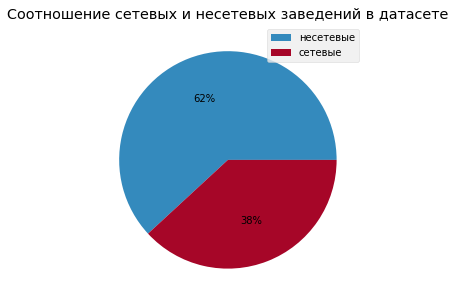

In [31]:
with plt.style.context('bmh'):
    o.plot.pie(y='name', labels=None, label='', autopct='%1.0f%%', figsize=(5,5))
    plt.title('Соотношение сетевых и несетевых заведений в датасете')
   
plt.show()

Из 8406 заведений 3205 сетевых, что составляет 38 %.

**Какие категории заведений чаще являются сетевыми? Исследуйте данные и ответьте на вопрос графиком.**

In [32]:
# посчитаем долю сетевых заведений по категориям
h = df.groupby('category')\
      .agg({'chain': 'mean'})\
      .sort_values(by='chain', ascending=False)\
      .reset_index()

h['chain'] = round(h['chain'],2)      
h        

,category,chain
0,булочная,0.61
1,пиццерия,0.52
2,кофейня,0.51
3,быстрое питание,0.38
4,ресторан,0.36
5,кафе,0.33
6,столовая,0.28
7,"бар,паб",0.22


In [33]:
fig = px.bar(h, x='category', y='chain', color='chain', text ='chain')
fig.update_layout(title='Доля сетевых заведений по категориям',
                  xaxis_title="Категории",
                  yaxis_title="Доля сетевых заведений")
                  
fig.show()

Чаще всего являются сетевыми булочные 61 %, пиццерий и кофейн на рынке примерно половина сетевых и несетевых, а чаще являются  несетевыми: заведения быстрого питания, рестораны, кафе, столовые, бары,пабы.

**Сгруппируйте данные по названиям заведений и найдите топ-15 популярных сетей в Москве. Под популярностью понимается количество заведений этой сети в регионе. Постройте подходящую для такой информации визуализацию. Знакомы ли вам эти сети? Есть ли какой-то признак, который их объединяет? К какой категории заведений они относятся?**

In [34]:
# топ-15 популярных сетей (по количеству заведений)
j = df.query('chain == 1')\
  .groupby(['name', 'category'], as_index = False)['lat']\
  .count().sort_values(by='lat', ascending=False).head(15)
j

,name,category,lat
1125,шоколадница,кофейня,119
496,домино'с пицца,пиццерия,76
489,додо пицца,пиццерия,74
205,one price coffee,кофейня,71
1141,яндекс лавка,ресторан,69
72,cofix,кофейня,65
241,prime,ресторан,49
617,кофепорт,кофейня,42
632,кулинарная лавка братьев караваевых,кафе,39
963,теремок,ресторан,36


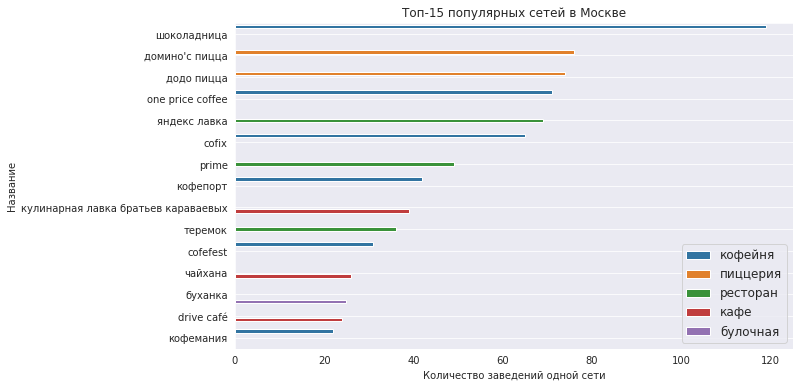

In [35]:
# используем стиль dark из библиотеки seaborn
sns.set_style('darkgrid')
# назначаем размер графика
plt.figure(figsize=(10, 6))
# строим столбчатый график средствами seaborn
sns.barplot(x='lat', y='name', data=j, hue='category')
# формируем заголовок графика и подписи осей средствами matplotlib
plt.title('Топ-15 популярных сетей в Москве')
plt.xlabel('Количество заведений одной сети')
plt.ylabel('Название')
# выбираем положение легенды и указываем размер шрифта
plt.legend(loc='lower right', fontsize=12)
# добавляем сетку
plt.grid()
# отображаем график на экране
plt.show()

Среди сетей лидером по количеству заведений является кофейня Шоколадница - 120 заведений в регионе. Из графика видно,что больше всего объектов одной сети встречается в категории Кофейня.

**Какие административные районы Москвы присутствуют в датасете? Отобразите общее количество заведений и количество заведений каждой категории по районам. Попробуйте проиллюстрировать эту информацию одним графиком.**

In [36]:
# посмотрим какие районы присутствуют в датасете
df['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [37]:
y = df.groupby(['district','category'], as_index=False)['name'].count()
y

,district,category,name
0,Восточный административный округ,"бар,паб",53
1,Восточный административный округ,булочная,25
2,Восточный административный округ,быстрое питание,71
3,Восточный административный округ,кафе,272
4,Восточный административный округ,кофейня,105
...,...,...,...
67,Южный административный округ,кафе,264
68,Южный административный округ,кофейня,131
69,Южный административный округ,пиццерия,73
70,Южный административный округ,ресторан,202


In [38]:
y.sort_values(by='name', ascending=False)

,district,category,name
46,Центральный административный округ,ресторан,670
43,Центральный административный округ,кафе,464
44,Центральный административный округ,кофейня,428
40,Центральный административный округ,"бар,паб",364
51,Юго-Восточный административный округ,кафе,282
...,...,...,...
32,Северо-Западный административный округ,"бар,паб",23
39,Северо-Западный административный округ,столовая,18
63,Юго-Западный административный округ,столовая,17
49,Юго-Восточный административный округ,булочная,13


In [39]:
fig = px.bar(y.sort_values(by='name', ascending=False), x='district', y='name', color='category', text ='name',
             width=1000, height=900)
fig.update_layout(title='Общее количество заведений и количество заведений каждой категории по районам',
                  xaxis_title="АО",
                  yaxis_title="Количество заведений",
                  xaxis={'categoryorder':'total ascending'})
fig.show()

График показывает, что Центральный административный округ лидирует по количеству заведений всех категорий. Меньше всего заведений в Северо-Западном административном округе.

In [40]:
#Код ревьюера
fig = px.bar(y.sort_values(by='name', ascending=True), 
             x='name',
             y='district',               
             color='category'
            )
fig.update_layout(title='Количество заведений каждой категории по районам',
                   xaxis_title='Количество заведений',
                   yaxis_title='Район',  
                   yaxis={'categoryorder':'total ascending'},
                   width=1000, 
                   height=550
                 )
fig.show()

**Визуализируйте распределение средних рейтингов по категориям заведений. Сильно ли различаются усреднённые рейтинги в разных типах общепита?**

In [41]:
f = df.pivot_table(index='category', values = 'rating').reset_index()
f['rating'] = round(f['rating'],3)
f

,category,rating
0,"бар,паб",4.388
1,булочная,4.269
2,быстрое питание,4.050
3,кафе,4.124
4,кофейня,4.277
5,пиццерия,4.301
6,ресторан,4.290
7,столовая,4.211


In [42]:
fig = px.bar(f.sort_values(by='rating', ascending=False), x='rating', y='category', text ='rating', color='category')
fig.update_layout(showlegend=False,
                  title='Распределение средних рейтингов по категориям заведений',
                  xaxis_title="Рейтинг",
                  yaxis_title="Категории заведений")
fig.show()

Средний рейтинг по категориям общепита различаются слабо, находится в диапазоне от 4,05 до 4,388 балов. Закономерностей не выявлено.

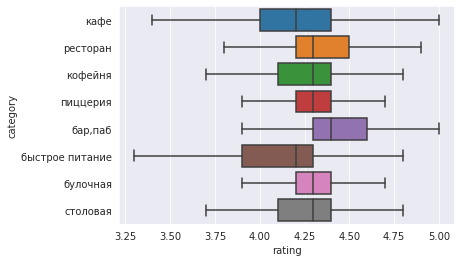

In [43]:
seaborn.boxplot(data=df, x='rating', y='category', showfliers=False)
plt.show()

**Постройте фоновую картограмму (хороплет) со средним рейтингом заведений каждого района. Границы районов Москвы, которые встречаются в датасете, хранятся в файле admin_level_geomap.geojson (скачать файл для локальной работы).**

In [44]:
rating_df = df.groupby('district', as_index=False)['rating'].agg('mean')
rating_df = round(rating_df,2).sort_values(by='rating',ascending=False)
rating_df

,district,rating
5,Центральный административный округ,4.38
2,Северный административный округ,4.24
4,Северо-Западный административный округ,4.21
1,Западный административный округ,4.18
8,Южный административный округ,4.18
0,Восточный административный округ,4.17
7,Юго-Западный административный округ,4.17
3,Северо-Восточный административный округ,4.15
6,Юго-Восточный административный округ,4.10


In [45]:
# подключаем модуль для работы с JSON-форматом
import json

# читаем файл и сохраняем в переменной
with open('/datasets/admin_level_geomap.geojson', 'r', encoding='utf-8') as f:
    geo_json = json.load(f)

print(json.dumps(geo_json, indent=2, ensure_ascii=False, sort_keys=True))



{
  "features": [
    {
      "geometry": {
        "coordinates": [
          [
            [
              [
                37.8756653,
                55.825342400000004
              ],
              [
                37.876001599999995,
                55.8249027
              ],
              [
                37.8730967,
                55.8237936
              ],
              [
                37.8689418,
                55.8228697
              ],
              [
                37.869206999999996,
                55.822363200000005
              ],
              [
                37.868322500000005,
                55.822211100000004
              ],
              [
                37.867472,
                55.823703
              ],
              [
                37.86851090000001,
                55.82391880000001
              ],
              [
                37.87046039999999,
                55.8242706
              ],
              [
                37.87172779999

In [46]:
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

# выводим карту
m



**Отобразите все заведения датасета на карте с помощью кластеров средствами библиотеки folium.**

In [47]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

# выводим карту
m

**Найдите топ-15 улиц по количеству заведений. Постройте график распределения количества заведений и их категорий по этим улицам. Попробуйте проиллюстрировать эту информацию одним графиком.**

In [48]:
top_streets = df.groupby(['street', 'category'], as_index = False)['name']\
                .count().sort_values(by='name',ascending=False).head(15)
top_streets

,street,category,name
2137,проспект мира,кафе,53
1520,мкад,кафе,45
2140,проспект мира,ресторан,44
2138,проспект мира,кофейня,36
2149,профсоюзная улица,кафе,35
2125,проспект вернадского,ресторан,33
1313,ленинский проспект,ресторан,33
1305,ленинградское шоссе,ресторан,26
1381,люблинская улица,кафе,26
1310,ленинский проспект,кафе,26


In [49]:
fig = px.bar(top_streets, x='street', y='name', color='category', text='name')
            
fig.update_layout(title='Топ-15 улиц по количеству заведений по категориям',
                  xaxis_title="Улицы",
                  yaxis_title="Количество заведений",
                  xaxis={'categoryorder':'total ascending'})
fig.show()

Проспект мира лидирует по количеству заведений. На втором месте - Профсоюзная улица, далее идут Ленинский проспект, проспект Вернадского.

In [50]:
#Код ревьюера
#Топ-15 улиц по количеству заведений:

street_top_15 = df.groupby('street').agg({'name' : 'count'}).reset_index()
street_top_15.columns = ['street', 'count']
street_top_15 = street_top_15.sort_values('count', ascending = False).reset_index().head(15)
street_top_15

,index,street,count
0,837,проспект мира,183
1,841,профсоюзная улица,122
2,834,проспект вернадского,108
3,533,ленинский проспект,107
4,531,ленинградский проспект,95
5,379,дмитровское шоссе,88
6,461,каширское шоссе,77
7,304,варшавское шоссе,76
8,532,ленинградское шоссе,70
9,610,мкад,65


In [51]:
#Код ревьюера
#Сгруппируем по категориям

df_street = df.groupby(['street', 'category'])['name'].count().reset_index()
df_street.columns = ['street', 'category', 'count']
df_street

,street,category,count
0,1-й автозаводский проезд,кафе,1
1,1-й балтийский переулок,ресторан,1
2,1-й варшавский проезд,кафе,1
3,1-й вешняковский проезд,кафе,1
4,1-й волоколамский проезд,кафе,1
...,...,...,...
3816,яузская улица,кофейня,3
3817,яузская улица,ресторан,1
3818,яузский бульвар,"бар,паб",1
3819,яузский бульвар,кафе,1


In [52]:
#Код ревьюера
#Оставим улицы из топ-15

df_street_top_15 = df_street[df_street['street'].isin(street_top_15['street'])]
df_street_top_15.head(15)

,street,category,count
698,варшавское шоссе,"бар,паб",6
699,варшавское шоссе,быстрое питание,7
700,варшавское шоссе,кафе,18
701,варшавское шоссе,кофейня,14
702,варшавское шоссе,пиццерия,4
703,варшавское шоссе,ресторан,20
704,варшавское шоссе,столовая,7
882,дмитровское шоссе,"бар,паб",6
883,дмитровское шоссе,булочная,2
884,дмитровское шоссе,быстрое питание,10


In [53]:
#Код ревьюера


fig = px.bar(df_street_top_15.sort_values(by='count', ascending=True), 
             x='count',
             y='street',               
             color='category'
            )
fig.update_layout(title='График распределения количества заведений и их категорий по улицам',
                   xaxis_title='Количество заведений',
                   yaxis_title='Улица',  
                   yaxis={'categoryorder':'total ascending'},
                   font=dict(size=14),
                   width=1000, 
                   height=600
                 )
fig.show()

**Найдите улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?**

In [54]:
g=df.groupby(['street', 'district'], as_index = False)['name'].count().query('name==1')
g

,street,district,name
0,1-й автозаводский проезд,Южный административный округ,1
1,1-й балтийский переулок,Северный административный округ,1
2,1-й варшавский проезд,Южный административный округ,1
3,1-й вешняковский проезд,Юго-Восточный административный округ,1
5,1-й голутвинский переулок,Центральный административный округ,1
...,...,...,...
1471,электрический переулок,Центральный административный округ,1
1478,юго-западный административный округ,Юго-Западный административный округ,1
1483,якиманский переулок,Центральный административный округ,1
1484,яковоапостольский переулок,Центральный административный округ,1


In [55]:
# улицы, на которых находится 1 объект общественного питания
g['street'].unique()

array(['1-й автозаводский проезд', '1-й балтийский переулок',
       '1-й варшавский проезд', '1-й вешняковский проезд',
       '1-й голутвинский переулок', '1-й грайвороновский проезд',
       '1-й дербеневский переулок', '1-й земельный переулок',
       '1-й капотнинский проезд', '1-й кирпичный переулок',
       '1-й колобовский переулок', '1-й котляковский переулок',
       '1-й курьяновский проезд', '1-й николощеповский переулок',
       '1-й новокузнецкий переулок', '1-й рижский переулок',
       '1-й самотёчный переулок', '1-й сетуньский проезд',
       '1-й спасоналивковский переулок', '1-й щипковский переулок',
       '1-я боевская улица', '1-я дубровская улица',
       '1-я курьяновская улица',
       '1-я линия хорошёвского серебряного бора', '1-я парковая улица',
       '1-я стекольная улица', '1-я фрунзенская улица',
       '1-я ямская улица', '11-я парковая улица', '12-я парковая улица',
       '14-я парковая улица', '16-я парковая улица',
       '17-й проезд марьиной рощи

In [56]:
g['street'].nunique()/df['street'].nunique()*100

32.757429163787144

Всего улиц с 1 объектом общественного питания 475, что составляет 32,7 %  от общего числа улиц, представленных в датасете. 

**Значения средних чеков заведений хранятся в столбце middle_avg_bill. Эти числа показывают примерную стоимость заказа в рублях, которая чаще всего выражена диапазоном. Посчитайте медиану этого столбца для каждого района. Используйте это значение в качестве ценового индикатора района. Постройте фоновую картограмму (хороплет) с полученными значениями для каждого района. Проанализируйте цены в центральном административном округе и других. Как удалённость от центра влияет на цены в заведениях?**

In [57]:
# посчитаем медиану среднего чека для каждого района
avg_bill_df = df.groupby('district', as_index=False)['middle_avg_bill'].median()\
              .sort_values(by='middle_avg_bill', ascending=False)
avg_bill_df

,district,middle_avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,575.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


In [58]:
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=avg_bill_df,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный чек заведений по районам',
).add_to(m)

# выводим карту
m


In [59]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['middle_avg_bill']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

# выводим карту
m

Чем больше удаленность от центра, тем ниже медианный чек заведения. В центральном и западном административных округах чек составляет 1000 р. Самый низкий чек - в Юго-Восточном административном округе составляет 450 р.	

**Необязательное задание: проиллюстрируйте другие взаимосвязи, которые вы нашли в данных. Например, по желанию исследуйте часы работы заведений и их зависимость от расположения и категории заведения. Также можно исследовать особенности заведений с плохими рейтингами, средние чеки в таких местах и распределение по категориям заведений.**

In [60]:
# разобъем рейтинг на категории (значения-низкий, средний, высокий) и добавляем столбец тип рейтинга
def type_rating(row):
    if 1 < row ['rating'] < 3:
        return 'low'
    elif 3.1<row['rating']<4.2:
        return 'average'
    else:
        return 'high'
df['type_rating'] = df.apply(type_rating, axis=1) 
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7,type_rating
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица дыбенко,False,high
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица дыбенко,False,high
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,клязьминская улица,False,high
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица маршала федоренко,False,high
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,правобережная улица,False,high


In [61]:
# посмотрим на средний чек в разрезе рейтинга
b = df.groupby(['category', 'type_rating'])['middle_avg_bill'].mean().reset_index()
b['middle_avg_bill'] = round(b['middle_avg_bill'],2)
b

,category,type_rating,middle_avg_bill
0,"бар,паб",average,973.51
1,"бар,паб",high,1382.08
2,"бар,паб",low,NaN
3,булочная,average,406.00
4,булочная,high,770.27
5,булочная,low,325.00
6,быстрое питание,average,419.40
7,быстрое питание,high,466.95
8,быстрое питание,low,343.33
9,кафе,average,562.87


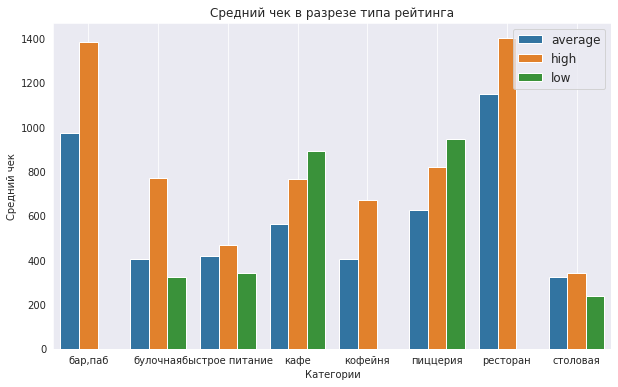

In [62]:
# используем стиль dark из библиотеки seaborn
sns.set_style('darkgrid')
# назначаем размер графика
plt.figure(figsize=(10, 6))
# строим столбчатый график средствами seaborn
sns.barplot(x='category', y='middle_avg_bill', data=b, hue='type_rating')
# формируем заголовок графика и подписи осей средствами matplotlib
plt.title('Cредний чек в разрезе типа рейтинга')
plt.xlabel('Категории')
plt.ylabel('Средний чек')
# выбираем положение легенды и указываем размер шрифта
plt.legend(loc='upper right', fontsize=12)
# добавляем сетку
plt.grid()
# отображаем график на экране
plt.show()


График показывает, что во всех категориях, кроме кафе, высокий рейтинг соответствует высокому уровеню среднего чека. В кафе наоборот, низкий рейтинг у кафе с высоким уровнем среднего чека.

In [63]:
config inlinebackend.figure_format = 'retina'

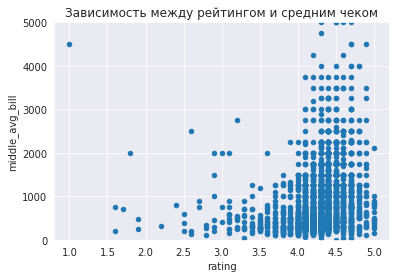

In [64]:
# посмотрим есть ли зависимость между рейтингом и средним чеком
df.plot(x='rating', y='middle_avg_bill', kind='scatter', title='Зависимость между рейтингом и средним чеком',
        ylim=(0, 5000))
plt.show()

In [65]:
df['rating'].describe()

count    8402.000000
mean        4.230017
std         0.470320
min         1.000000
25%         4.100000
50%         4.300000
75%         4.400000
max         5.000000
Name: rating, dtype: float64

- Зависимости между рейтингом и средним чек не выявлено. 
- 75 % данных по рейтингу имеют отметку от 4 баллов, то есть пользователи в большинстве своем дают положительную оценку заведению.

In [66]:
df.groupby(['category'])['middle_avg_bill'].median().reset_index().sort_values(by='middle_avg_bill',ascending=False)

,category,middle_avg_bill
0,"бар,паб",1250.0
6,ресторан,1250.0
5,пиццерия,600.0
3,кафе,550.0
1,булочная,450.0
4,кофейня,400.0
2,быстрое питание,375.0
7,столовая,300.0


Медианный чек в барах, пабах, ресторанах гораздо выше чем в других категориях заведений. Самый низкий чек в столовых и заведениях быстрого питания.	

**Вывод:**
- Больше всего на рынке общественного питания г. Москвы присутствуют кафе 2378 заведений, далее рестораны 2043 заведения, на третьем месте кофейни 1413. Меньше всего булочных 256 заведений и столовых - 315.
- По количеству посадочных мест выходят на первое место рестораны, на второе поместились кафе, на третьем кофейни. 
В ресторанах в среднем 99, В барах/пабах - 93, в кофейнях - 90, быстрое питание - 85, меньше всего в кафе 78 мест. По-медиане наибольшее количество посадочных мест в категории объектов Ресторанах и Барах/пабах одинаковое количество посадочных мест - в среднем 80, далее столовые - 72, кофейни - 70, быстрое питание - 60, меньше всего мест в булочной - 48.
- Из 8406 заведений 3205 сетевых, что составляет 38 %.
- Чаще всего являются сетевыми булочные 61 %, пиццерий и кофейн на рынке примерно половина сетевых и несетевых, а чаще являются несетевыми: заведения быстрого питания, рестораны, кафе, столовые, бары,пабы.
- Лидером по количеству заведений является сеть Шоколадница - 120 заведений в регионе. 
- Центральный административный округ лидирует по количеству заведений всех категорий. Меньше всего заведений в Северо-Западном административном округе.
- Средний рейтинг по категориям общепита различаются слабо, и находится в диапазоне от 4,05 до 4,388 балов, т.е. чаще пользователи ставят баллы выше 4.
- Проспект мира лидирует по количеству заведений. На втором месте - Профсоюзная улица, далее идут Ленинский проспект, проспект Вернадского.
- Всего улиц с 1 объектом общественного питания 475, что составляет 32,7 % от общего числа улиц, представленных в датасете.
- Чем больше удаленность от центра, тем ниже медианный чек заведения. В центральном и западном административных округах медианный чек составляет 1000 р. Самый низкий чек - в Юго-Восточном административном округе- 450 р.
- Медианный чек в барах, пабах, ресторанах гораздо выше чем в других категориях заведений. Самый низкий чек в столовых и заведениях быстрого питания, что ожидаемо.


### Детализируем исследование: открытие кофейни

Ответьте на следующие вопросы:
- Сколько всего кофеен в датасете? 
- В каких районах их больше всего, каковы особенности их расположения?
- Есть ли круглосуточные кофейни?
- Какие у кофеен рейтинги? Как они распределяются по районам?
- На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

In [67]:
print("Всего кофеен в датасете:", df.query('category== "кофейня"')['name'].count())

Всего кофеен в датасете: 1413


**В каких районах их больше всего, каковы особенности их расположения?**

In [68]:
df.query('category== "кофейня"')\
  .groupby('district')['name'].count()\
  .reset_index().sort_values(by='name',ascending=False)

,district,name
5,Центральный административный округ,428
2,Северный административный округ,193
3,Северо-Восточный административный округ,159
1,Западный административный округ,150
8,Южный административный округ,131
0,Восточный административный округ,105
7,Юго-Западный административный округ,96
6,Юго-Восточный административный округ,89
4,Северо-Западный административный округ,62


Больше всего кофеен находится Центральном административном округе 428, гораздо меньше в других округах, в Юго-Восточном административном округе -	89, Северо-Западном административном округе	всего 62 кофейни.

**Есть ли круглосуточные кофейни?**

In [69]:
df.query('category="кофейня"' and 'is_24_7==True')['name'].reset_index()

,index,name
0,10,great room bar
1,17,чайхана беш-бармак
2,19,пекарня
3,24,drive café
4,49,2u-ту-ю
...,...,...
725,8394,намангале
726,8399,"пекарня, кафе-гриль"
727,8403,самовар
728,8404,чайхана sabr


Круглосуточных кофейн 730 заведений.

In [70]:
#Код ревьюера
df_coffeehouse = df[df['category'] == 'кофейня']
df_coffeehouse.count()[0]

1413

In [71]:
#Код ревьюера
coffeehouse_24_7 = df_coffeehouse[df_coffeehouse['is_24_7'] == True]
coffeehouse_24_7.count()[0]

59

**Какие у кофеен рейтинги? Как они распределяются по районам?**

In [72]:
l = df_coffeehouse.groupby(['district','type_rating'])['name'].count().reset_index()
l

,district,type_rating,name
0,Восточный административный округ,average,29
1,Восточный административный округ,high,76
2,Западный административный округ,average,54
3,Западный административный округ,high,94
4,Западный административный округ,low,2
5,Северный административный округ,average,54
6,Северный административный округ,high,136
7,Северный административный округ,low,3
8,Северо-Восточный административный округ,average,53
9,Северо-Восточный административный округ,high,103


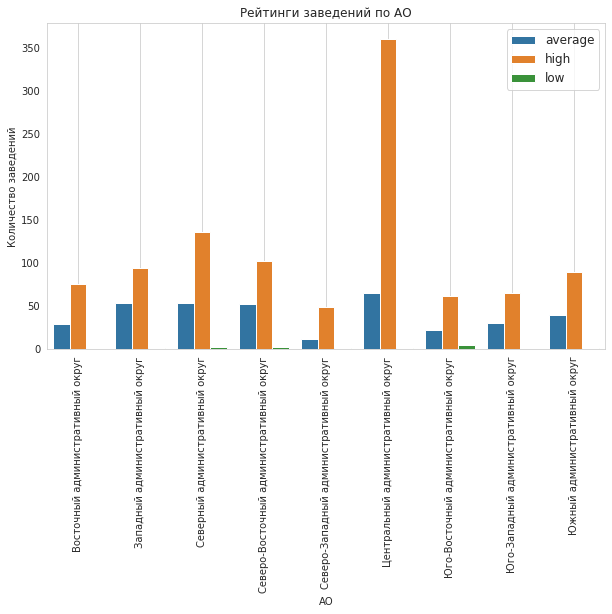

In [73]:
# используем стиль dark из библиотеки seaborn
sns.set_style('whitegrid')
# назначаем размер графика
plt.figure(figsize=(10, 6))
# строим столбчатый график средствами seaborn
sns.barplot(x='district', y='name', data=l, hue='type_rating')
# формируем заголовок графика и подписи осей средствами matplotlib
plt.title('Рейтинги заведений по АО')
plt.xlabel('АО')
plt.ylabel('Количество заведений')
plt.xticks(rotation=90)           
# выбираем положение легенды и указываем размер шрифта
plt.legend(loc='upper right', fontsize=12)
# добавляем сетку
plt.grid()
# отображаем график на экране
plt.show()

Наибольшие количество заведений с высоким рейтингом находится в Центральном административном округе. 

In [74]:
#Код ревьюера
coffeehouse_rating_district = df_coffeehouse.groupby('district').agg({'rating' : 'mean'})\
                                            .round(2).sort_values('rating', ascending = False)
coffeehouse_rating_district = coffeehouse_rating_district.reset_index()
coffeehouse_rating_district

,district,rating
0,Центральный административный округ,4.34
1,Северо-Западный административный округ,4.33
2,Северный административный округ,4.29
3,Восточный административный округ,4.28
4,Юго-Западный административный округ,4.28
5,Юго-Восточный административный округ,4.23
6,Южный административный округ,4.23
7,Северо-Восточный административный округ,4.22
8,Западный административный округ,4.20


**На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?**

In [75]:
# посмотрим на среднюю/медианную стоимость по всем заведениям
df['middle_coffee_cup'].describe()

count     535.000000
mean      174.721495
std        88.951103
min        60.000000
25%       124.500000
50%       169.000000
75%       225.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

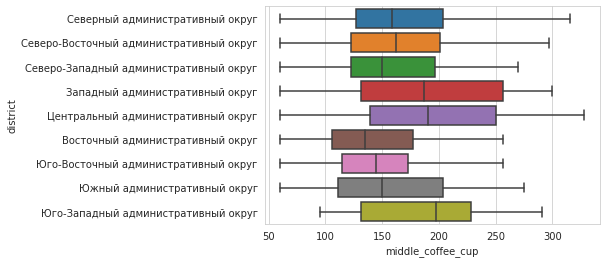

In [76]:
# построим разброс стоимостей чашки капучино по АО 
seaborn.boxplot(data=df, x='middle_coffee_cup', y='district', showfliers=False)
plt.show()

In [77]:
# медианная стоимость по АО
df.groupby('district')['middle_coffee_cup'].median()

district
Восточный административный округ           135.0
Западный административный округ            187.0
Северный административный округ            159.0
Северо-Восточный административный округ    162.5
Северо-Западный административный округ     150.0
Центральный административный округ         190.0
Юго-Восточный административный округ       145.0
Юго-Западный административный округ        197.0
Южный административный округ               149.5
Name: middle_coffee_cup, dtype: float64

Стоимость чашки капучино будет зависеть от места открытия заведения, по-стоимости надо ориентироваться в пределах 340 руб, так как это значение максимальная граница по всем АО, не считая выбросы.

**Рекомендации:**

Для нашей цели открыть заведение, рекомендации будут зависеть от типа выбранного объекта. Для заведения категории столовые или быстрое питание больше всего подходят наиболее проходимые улицы с большим трафиком людей из списка топ-15, с другой стороны выдержит ли оно конкуренцию. Для открытия ресторана могут подойти более спокойные улицы, при услови что ресторан будет выделяться престижностью, так как в такое место посетители будут целеноправлено добираться. Если выбранное заведение - кофейня, то  стоимость чашки капучино стоит выбрать не более чем медианное/среднее значение  169-174 р., так как стоимость выше среднего у сетей с уже существующими лояльными, постоянными клиентами, в другом случае тогда качество продукта должно качественно выделяться от предложений на рынке.
Для более точных рекомендаций не хватает данных по стоимости аренды, выручке и посещаемости конкурентов.

Презентация: https://disk.yandex.ru/i/YlMydjuO0Fly-Q